In [1]:
# ipython settings
%load_ext autoreload
%autoreload 2
import warnings

warnings.filterwarnings('ignore')

In [2]:
# imports
import sys
sys.path.append('../BioExp')
import keras
import numpy as np
import tensorflow as tf
from keras.models import load_model
import pandas as pd
import os
import pickle

from keras.backend.tensorflow_backend import set_session
from BioExp.helpers.metrics import *
from BioExp.helpers.losses import *

Using TensorFlow backend.


In [3]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

[]

In [4]:
# GPU setup
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.9
set_session(tf.Session(config=config))

<h1><center>APTOS 2019 Blindness Detection</center></h1>
<h2><center>Detect diabetic retinopathy to stop blindness before it's too late</center></h2>
<center><img src="https://raw.githubusercontent.com/dimitreOliveira/MachineLearning/master/Kaggle/APTOS%202019%20Blindness%20Detection/aux_img.png"></center>

In this notebook we'll analyse the classification network (ResNet50) trained on APTOs data.

In [5]:
# model and parameter defn
# currently using ResNet50

model_path        = 'saved_models/APTOS/APTOS_DR_model_ResNet50.h5'
weights_path      = 'saved_models/APTOS/APTOS_DR_ResNet50_weights.h5py'

model = load_model(model_path)
model.load_weights(weights_path)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



In [6]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 518, 518, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 256, 256, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 256, 256, 64) 256         conv1[0][0]                      
____________________________________________________________________________________________

In [7]:
# considered layers for analysis

layers_to_consider = ['conv1', 'res2a_branch2a', 'res2c_branch2c', 'res3a_branch2a', 'res3d_branch2c', 'res4a_branch2a', 'res4f_branch2c', 'res5a_branch2a', 'res5c_branch2c']

## Proposed method
![pipeline](./imgs/graph.png)
The above figure illustrates the framework proposed for interpretability of deep learning models. According to which the we

The proposed framework for understanding the deep learning models consists multiple steps, which consists (i) concept formation, (ii) concept significance analysis, (iii) concept identification, (iv) network formation, and (v) trail estimation. Above figure provides the detailed overview of the above framework.


![pipeline](./imgs/pipeline2.png)

--------------

## Concept Formation

It's observed that few weights are mainly responsible for detecting/encoding certain features in an image \cite{}. In this work, we consider that assumption to group all the weights responsible for detecting certain features. Group of all the weights responsible for a particular feature forms in an individual cluster which encodes a particular human-understandable or non-understandable concept. Most of our further analysis considers these concepts at the core; this method of grouping weights makes interventional, and our interpretation steps more tractable for deep learning models. For faster inference, we make layer selection as a hyperparameter, i.e., we don't run inference on the entire network but select some layers and construct the links among the concepts between them. 

Let the trained network be $\Phi(W, X)$, and considered layers for analysis are $\{..., l-n, l, l+m, ... \}$. The clusters $\{C^l_p, C^l_q, C^l_r, ...\}$ are formed as a result of clustering weights at layer $l$ in the network $\Phi$. 

Let $W = \{ w_1, w_2,..., w_n\}$, where $W\in\mathbb{R}^{3 \times 3 \times inc \times outc}$ and $w_i \in \mathbb{R}^{3 \times 3 \times inc}$, after vectorization $W \in \mathbb{R}^{9inc \times outc}$ and $w_i \in \mathbb{R}^{9inc \times 1}$. To increase the difference between two simialr weights we encode position information \cite{} along with weights $w_i = w_i + X$, where $X$ is a vector along the plane $X=Y$ in same vector space as $w_i$. Encoding such non symmetrical position information ensures higher distance between two vectors with similar intensity values but different orientations. 

These modified weights are used in cluster formation. Clusters are formed using a hierarchical clustering method \cite{} using distance-based thresholding rather than fixing the number of clusters. This provides additional degrees of freedom to group weights into as many numbers of significantly different concepts.

After obtaining the clusters, weights are arranged accordingly to observe similarity among the clustered weights. Figure \ref{} depicts the same. But it's hard to interpret these weights directly due to their high dimensionality, using metrics like $\mathbb{E}(cosine~similarity)$ we can easily quantify the difference among these clusters.

In [8]:
from BioExp.clusters import clusters

concept_info = []
node = 0

save_root = './Logs/APTOS/weights_cluster/'
for i, layer_name in enumerate(layers_to_consider):
    save_path = os.path.join(save_root, layer_name)
    os.makedirs(save_path, exist_ok = True)
    
    C = clusters.Cluster(model, weights_path, layer_name)
    labels = C.get_clusters(threshold = .50, 
                            normalize = True,
                            position  = False,
                            save_path = save_path)
    C.plot_weights(labels, os.path.join(save_path, 'wt-samples'))
    
    for label in np.unique(labels):
        nodename = 'node_{}'.format(node)
        layername = layer_name
        fidxs = np.where(labels==label)[0]
        info = {'concept_name': nodename, 
                  'layer_name': layername, 
                 'filter_idxs': fidxs,
                  'node_order': i}
        concept_info.append(info)
        node += 1
        
with open(os.path.join(save_root, 'cluster_info.cpickle'), 'wb') as file:
    pickle.dump(concept_info, file)

[INFO: BioExp Clustering] Layer: conv1, Nclusters: 3, Labels: [0 1 2], Freq. of each labels: [49, 8, 7] Clustering Score: 0.3239152729511261
[INFO: BioExp Clustering] Layer: res2a_branch2a, Nclusters: 1, Labels: [0 1], Freq. of each labels: [25, 39] Clustering Score: 0.6292499899864197
[INFO: BioExp Clustering] Layer: res2c_branch2c, Nclusters: 2, Labels: [0 1], Freq. of each labels: [123, 133] Clustering Score: 0.4998655319213867
[INFO: BioExp Clustering] Layer: res3a_branch2a, Nclusters: 3, Labels: [0 1 2], Freq. of each labels: [45, 21, 62] Clustering Score: 0.5514629483222961
[INFO: BioExp Clustering] Layer: res3d_branch2c, Nclusters: 8, Labels: [0 1 2 3 4 5 6 7], Freq. of each labels: [15, 91, 59, 91, 102, 70, 11, 73] Clustering Score: 0.5164767503738403
[INFO: BioExp Clustering] Layer: res4a_branch2a, Nclusters: 3, Labels: [0 1 2], Freq. of each labels: [94, 126, 36] Clustering Score: 0.5462215542793274
[INFO: BioExp Clustering] Layer: res4f_branch2c, Nclusters: 6, Labels: [0 1 2

#### GradCAM revist
![cam](./imgs/gradcam.png)

-----
## Concept Identification

Concept identification is the step where we try to associate formed clusters to some region in an input image. For which, we use a gradient-based method. Consider concept $C^l_p$ to identify the corresponding region activated in an input image. We first modify the trained network by dissecting the network at layer $l$ described as $\Phi_l$ and intervening the concepts other than concept $p$ to zeros i.e., $do(C^l_{-p} = 0)$. Now we compute gradient activated regions for all the feature maps \cite{} in $p$ and consider their expectation to be the identified feature. Equations below illustrate the same.

\begin{equation}
    y(l, k, x) = \dfrac{1}{P} \sum_{i} \sum_{j} \Phi^{'}_{l, k}(x) 
\end{equation}

\begin{equation}
    \beta(l, k, x) = \dfrac{1}{N}\sum_{i} \sum_{j} \dfrac{\partial y(l, k, x)} {\partial \Phi^{'ij}_{l, k}(x)}
\end{equation}

\begin{equation}
    Concept = \mathbb{E}_{k \sim fidxs_p} \left (ReLU\left ( \beta(l, k, x) \Phi^{'}_{l, k}(x) \right) \right)  
\end{equation}

As the gradient is a linear operation, we approximate the expectation of gradient activated regions of all the feature maps to the gradient activated region of the expected feature map, which is $\mathbb{E}_{k \sim idx_p} (GradCAM(fmap_k)) \approx GradCAM(\mathbb{E}_{k \sim idx_p}(fmap_k))$. 
To achieve the same, we further modify the network $\Phi_l$ by adding $(1\times 1)$ convolution at the end, which results in $\Phi^{'}_{l}$, which computes the expectation of feature maps of all the feature maps belonging to concept $p$. 



Once when the concepts are identified, we conduct a significance analysis to ensure that the concepts formed are consistent and are localized.

To accomplish this, we first generate the distribution for each concept. As the weights belonging to a specific layer can be considered as i.i.d \cite{}, by this assumption, we consider all the weights belonging to a particular cluster and generate a distribution using Gaussian as a prior.

Let $w \in C^l_p$ and $w \in \mathbb{R}^{3 x 3 x inc}$, we have such $n$ w's in a particular concept. The $1^{st}$ order moment information of these samples are used to generate Gaussian distribution. Obtained distribution $G(\mu, \sigma) = \sigma ^{-0.5} \exp \{- \frac{\mu^2}{\sigma ^2}\}$ where $\mu = \mathbb{E}_{w \sim idx_p}(w)$ and $\sigma = \mathbb{E}_{w \sim idx_p}(w - \mathbb{E}_{w \sim idx_p}(w))$, the distribution here is considered in pixel space. 

Once when we have the distribution, we sample several concepts and run concept identification test to map the similarities between original and sampled concepts. A concept with higher variance with respect to an original concept is removed entirely from further tests, as it doesn't coherently map to any concepts in an input image.

In [8]:
# dataloader
from PIL import Image
def dataloader(path):
    image = np.array(Image.open(path).convert('RGB').resize((512,512)))
    return image*1./255., 0
    

In [9]:
from BioExp.clusters.concept import ConceptIdentification
from BioExp.helpers import utils
from glob import glob

root_dir = '../BioExp/sample_vol/DR/'
classes = os.listdir(root_dir)

save_root = './Logs/APTOS/weights_cluster/'
with open(os.path.join(save_root, 'cluster_info.cpickle'), 'rb') as file:
    concepts_info = pickle.load(file)
        

for cls in classes:
    if not cls in ['Severe', 'Proliferative']: continue
        
    image = dataloader(glob(root_dir+cls+'/*.png')[0])[0]
    identifier = ConceptIdentification(model, weights_path)
    
    save_root = './Logs/APTOS/concept_identification/{}'.format(cls)
    
    for concept_info in concepts_info:
        # if int(concept_info['concept_name'].split("_")[-1])< 19: continue
        identifier.flow_based_identifier(concept_info, 
                               save_path = os.path.join(save_root, 
                                                        concept_info['layer_name']), 
                               test_img = image)

#         identifier.check_robustness(concept_info,
#                                 save_path = os.path.join(save_root, 
#                                                          concept_info['layer_name']), 
#                                 test_img = image,
#                                 save_all = True,
#                                 nmontecarlo = 2)


[INFO: BioExp Concept Identification] Identified Concept node_0 in layer conv1
[INFO: BioExp Concept Identification] Identified Concept node_1 in layer conv1
[INFO: BioExp Concept Identification] Identified Concept node_2 in layer conv1
[INFO: BioExp Concept Identification] Identified Concept node_3 in layer res2a_branch2a
[INFO: BioExp Concept Identification] Identified Concept node_4 in layer res2a_branch2a
[INFO: BioExp Concept Identification] Identified Concept node_5 in layer res2c_branch2c
[INFO: BioExp Concept Identification] Identified Concept node_6 in layer res2c_branch2c
[INFO: BioExp Concept Identification] Identified Concept node_7 in layer res3a_branch2a
[INFO: BioExp Concept Identification] Identified Concept node_8 in layer res3a_branch2a
[INFO: BioExp Concept Identification] Identified Concept node_9 in layer res3a_branch2a
[INFO: BioExp Concept Identification] Identified Concept node_10 in layer res3d_branch2c
[INFO: BioExp Concept Identification] Identified Concept 

In [ ]:
# consistence test

from BioExp.clusters.concept import ConceptIdentification
from BioExp.helpers import utils
from glob import glob

root_dir = '../BioExp/sample_vol/DR/NoDR'
classes = os.listdir(root_dir)

save_root = './Logs/APTOS/weights_cluster/'
with open(os.path.join(save_root, 'cluster_info.cpickle'), 'rb') as file:
    concepts_info = pickle.load(file)
    
selected_images = os.listdir(root_dir)[:6]
selected_nodes = ['node_3', 'node_10', 'node_6']
for img in selected_images: 
    save_root = './Logs_consistence/{}/concept_identification/{}/'.format('APTOS', img)

    image, gt = dataloader(os.path.join(root_dir, img))
    for concept_info in concepts_info:
        if not (concept_info['concept_name'] in selected_nodes): continue
        identifier.flow_based_identifier(concept_info, 
                               save_path = os.path.join(save_root), 
                               test_img = image)

In [ ]:
# Robustness tet

from BioExp.clusters.concept import ConceptIdentification
from BioExp.helpers import utils

root_dir = '../BioExp/sample_vol/DR/NoDR'

save_root = './Logs/APTOS/weights_cluster/'
with open(os.path.join(save_root, 'cluster_info.cpickle'), 'rb') as file:
    concepts_info = pickle.load(file)

        
image = dataloader(glob(root_dir+cls+'/*.png')[0])[0]

save_root = './Logs_robustness/APTOS/concept_identification'

for concept_info in concepts_info:   
    if not (concept_info['concept_name'] == 'node_3'): continue
    identifier.check_robustness(concept_info,
                            save_path = os.path.join(save_root, 'basegaussian'), 
                            test_img = image,
                            save_all = True,
                            nmontecarlo = 10,
                            base = True,
                            prior = 'gaussian')
    identifier.check_robustness(concept_info,
                        save_path = os.path.join(save_root, 'baseuniform'), 
                        test_img = image,
                        save_all = True,
                        nmontecarlo = 10,
                        base = True,
                        prior = 'uniform')
    identifier.check_robustness(concept_info,
                            save_path = os.path.join(save_root, 'gaussian'), 
                            test_img = image,
                            save_all = True,
                            nmontecarlo = 10,
                            prior = 'gaussian')
    identifier.check_robustness(concept_info,
                            save_path = os.path.join(save_root, 'uniform'), 
                            test_img = image,
                            save_all = True,
                            nmontecarlo = 10,
                            prior = 'uniform')

========= Node 0========


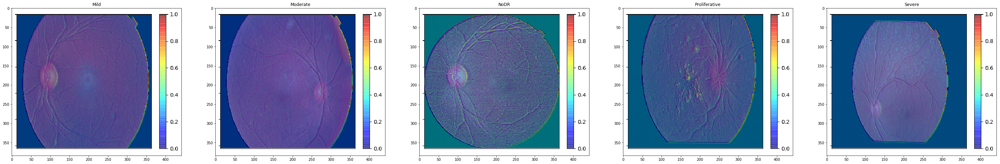

========= Node 1========


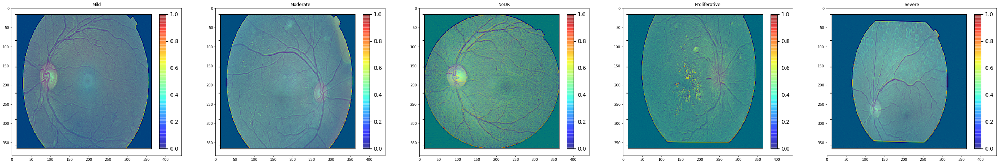

========= Node 2========


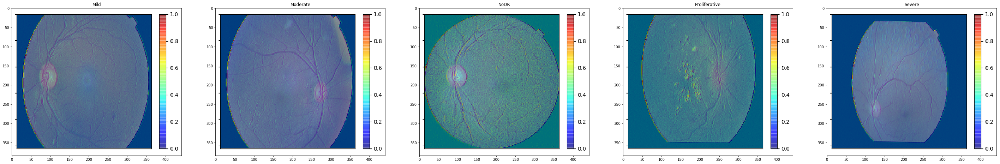

========= Node 3========


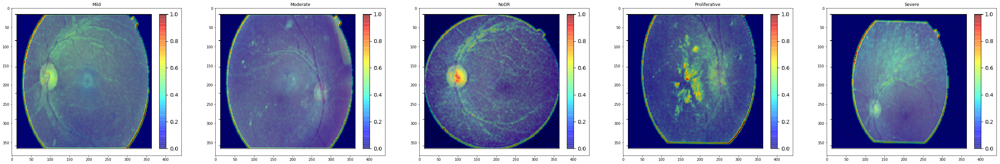

========= Node 4========


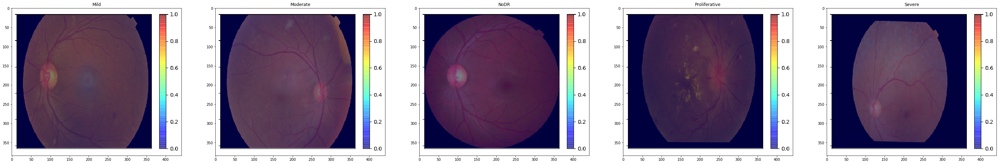

========= Node 5========


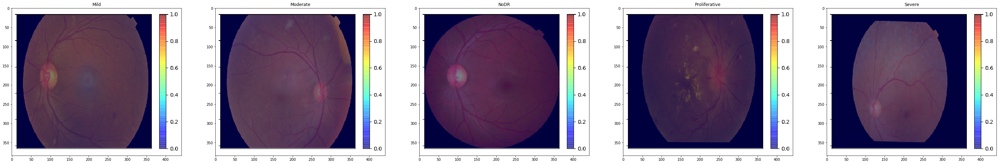

========= Node 6========


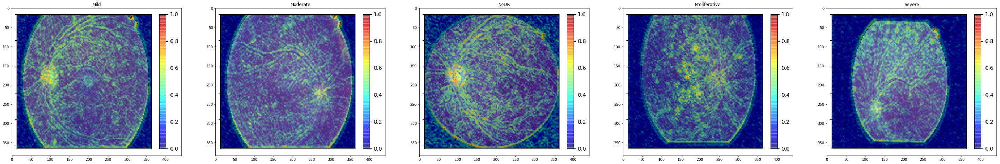

========= Node 7========


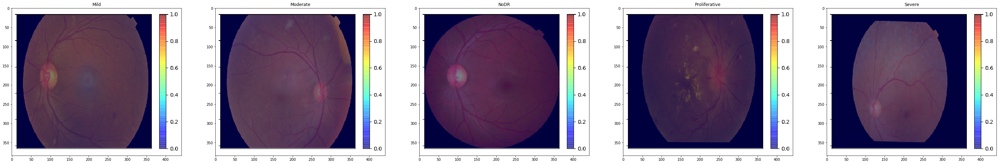

========= Node 8========


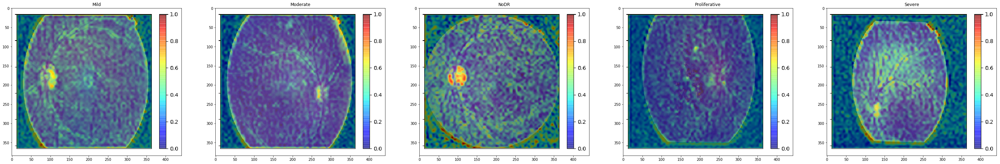

========= Node 9========


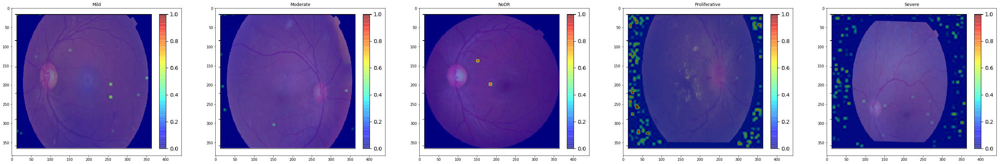

========= Node 10========


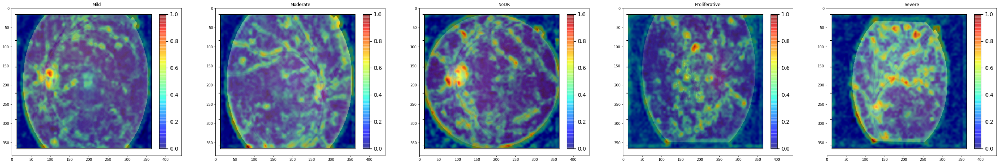

========= Node 11========


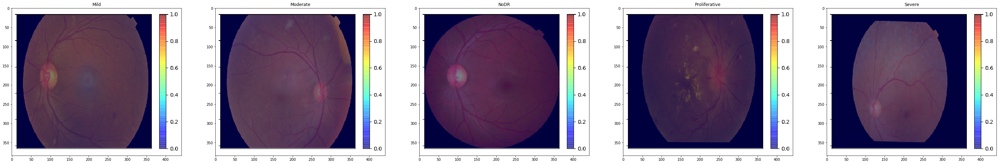

========= Node 12========


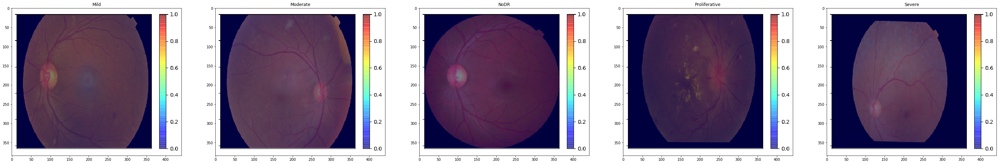

========= Node 13========


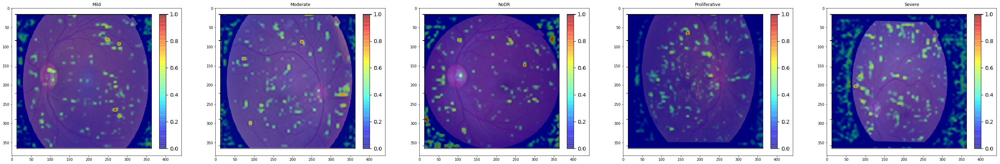

========= Node 14========


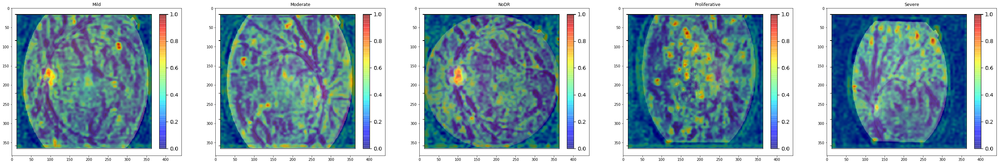

========= Node 15========


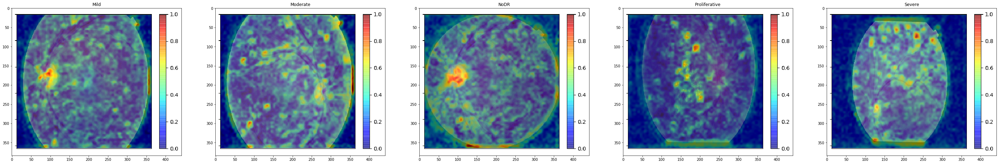

========= Node 16========


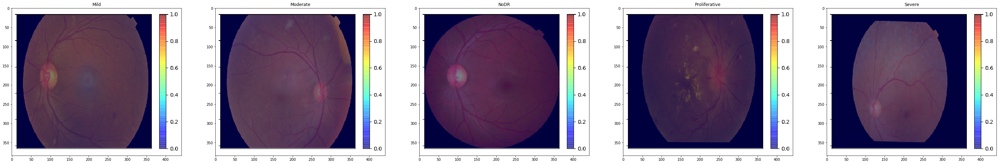

========= Node 17========


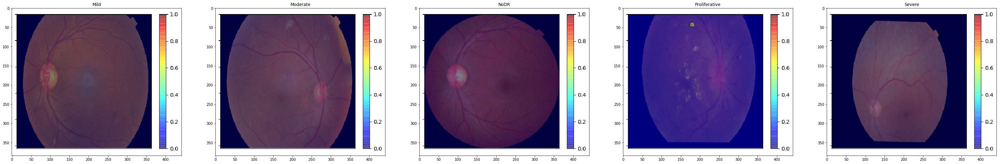

========= Node 18========


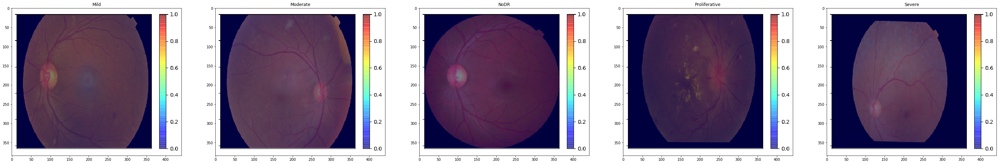

========= Node 19========


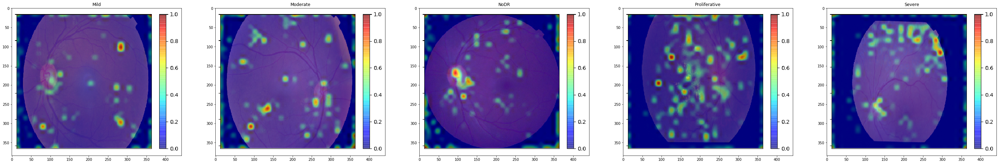

========= Node 20========


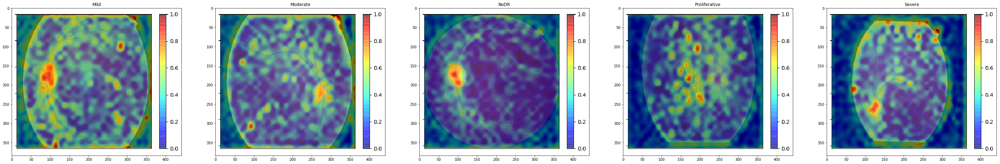

========= Node 21========


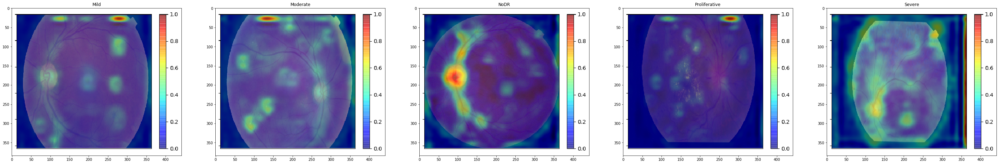

========= Node 22========


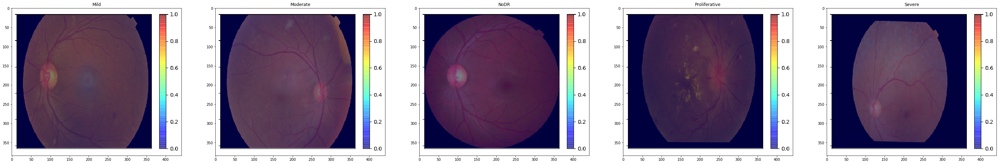

========= Node 23========


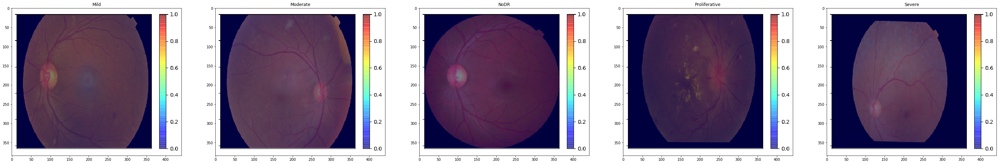

========= Node 24========


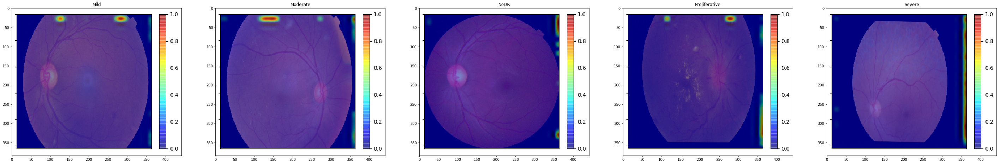

========= Node 25========


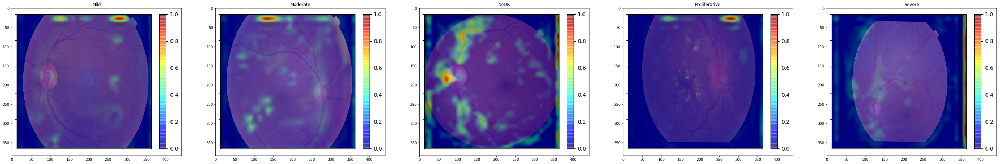

========= Node 26========


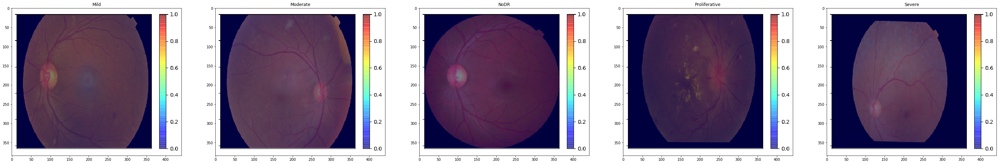

========= Node 27========


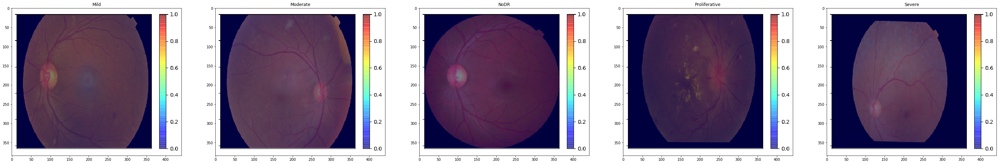

========= Node 28========


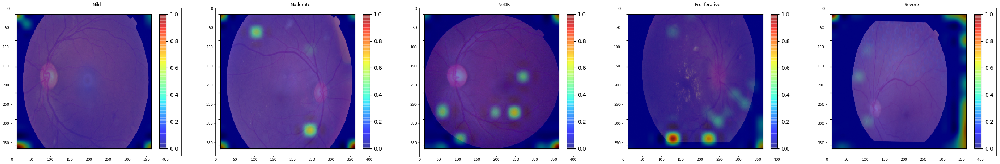

========= Node 29========


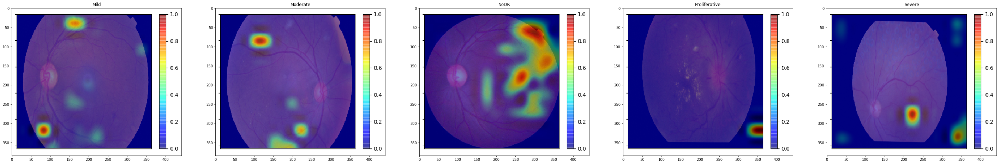

========= Node 30========


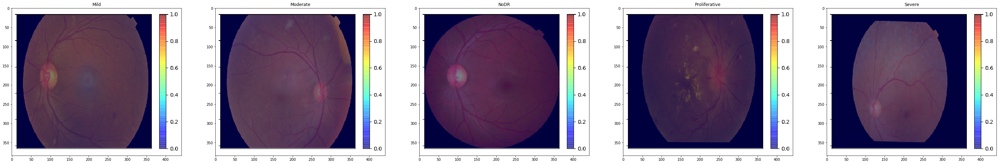

In [11]:
from glob import glob
from PIL import Image
import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt

save_root = './Logs/APTOS/concept_identification'
paths = np.array([pth for pth in glob(save_root + '/*/*.png') if not pth.__contains__('robustness')])
for i in range(31):
    print ("========= Node {}========".format(i))
    plt.figure(figsize = (50, 10))
    for j, cls in enumerate(classes):
        pth = glob(os.path.join(save_root, cls, '*/node_{}.png'.format(i)))[0]
        plt.subplot(1, len(classes), j+1)
        plt.title(cls)
        plt.imshow(np.array(Image.open(pth)))
    plt.show()


In [14]:
# These descriptions are provided manually by the user, 
# based on the way he/she interprets above images
# In this case we use atlas to obtain proper description


from pprint import pprint
consider_nodes = [
    {'node': 1, 'description': 'Local feature: left lateral edges'}, 
                  {'node': 2, 'description': 'Local feature: right lateral edges'},
                  {'node': 3, 'description': 'Hard exodates in proliferative, and optic disk in Normal'},
                  {'node': 6, 'description': 'All blood vessels'},
                  {'node': 8, 'description': 'Optic disk and blood vessels'},
                  {'node': 10, 'description': 'Blood vessels (eroded)'},
                  {'node': 14, 'description': 'Inverted Blood vessel (eroded) Image'},
                  {'node': 15, 'description': 'Optic disk and White spots (may be exodates)'},
                  {'node': 19, 'description': 'White spots (may be exodates)'},
                  {'node': 20, 'description': 'Optic disk and Hard exodates'},
                  {'node': 29, 'description': 'Dark spots'}
                ]

# update cluster info
save_root = './Logs/APTOS/weights_cluster/'
with open(os.path.join(save_root, 'cluster_info.cpickle'), 'rb') as file:
    concepts_info = pickle.load(file)
    
modified_concepts = []
for concept_info in concepts_info:
    for i, node in enumerate(consider_nodes):
        if node['node'] == int(concept_info['concept_name'].split('_').pop()):
            concept_info['description'] = consider_nodes[i]['description']
            pprint(concept_info)
            modified_concepts.append(concept_info)
            break

with open('./Logs/APTOS/modified_clusters.cpickle', 'wb') as file:
    pickle.dump(modified_concepts, file)  

{'concept_name': 'node_1',
 'description': 'Local feature: left lateral edges',
 'filter_idxs': array([ 0, 11, 14, 21, 47, 53, 55, 60]),
 'layer_name': 'conv1',
 'node_order': 0}
{'concept_name': 'node_29',
 'description': 'Dark spots',
 'filter_idxs': array([   2,    3,    6,    7,    9,   13,   15,   17,   19,   21,   24,
         27,   29,   33,   34,   36,   40,   42,   45,   46,   47,   48,
         49,   50,   51,   52,   55,   57,   58,   59,   60,   61,   65,
         66,   68,   69,   72,   75,   76,   77,   78,   81,   83,   84,
         85,   86,   88,   92,   96,   97,   98,   99,  100,  101,  102,
        103,  105,  106,  107,  109,  110,  112,  113,  114,  115,  116,
        121,  123,  124,  125,  126,  128,  129,  130,  131,  132,  135,
        136,  139,  140,  149,  151,  153,  158,  159,  160,  161,  162,
        164,  166,  170,  171,  174,  175,  178,  180,  182,  183,  186,
        190,  192,  197,  199,  203,  205,  214,  215,  219,  220,  223,
        226,  227

----------

### Causal Graph Links


![causallinkage](./imgs/causality_linkage.png)

Any deep learning models are inherently correlation-based; they try to map an input to output \cite{}. By constraining the network accordingly, we can try to estimate hidden causal links responsible for feature map activations. In this step, we try to estimate links between the significant concepts formed in the above steps. These links capture causal interactions between the concepts. 

To construct this graph, we work with feature map distributions; mathematically, the link between two concept nodes exists if $MI$ (Mutual Information) between the feature map distributions is higher than a threshold value, described in bellow equations.

Let, $C_i^l$ denotes the $i^{th}$ concept in layer $l$. The directed link $C_i^p \rightarrow C_j^q$ is determined by $MI(\mathbb{Q}(x~|~\Phi_{j,q}), \mathbb{Q}(x~|~\Phi_{q}))$, where $\mathbb{Q}$ is the distribution of feature maps obtained by considering network $\Phi$. $\mathbb{Q}(x~|~\Phi_{j,q})$ is the distribution of feature maps generated as a result of considering just single concept $C_j^q$, while $\mathbb{Q}(x~|~\Phi_{q})$ is the distribution generated by considering all the concepts in layer $q$ and setting all $C_{-i}^p$ to zeros.

The directed link $C_i^p \rightarrow C_j^q$, exists only if $MI(\mathbb{Q}(x~|~\Phi_{j,q}), \mathbb{Q}(x~|~\Phi_{q})) > T$, i.e., the information between post-interventional distribution and pre-interventional distribution is higher than a threshold value. Equation \ref{} describes the same.

$$MI(C_j^q, ~do(C_i^p = 1) ~|~ do(C_{-i}^p = 0), ~do(C_{-j}^q = 0)) - MI(C_j^q, ~do(C_i^p = 0) ~|~ do(C_{-i}^p = 0), ~do(C_{-j}^q = 0)) > T$$
$$\Rightarrow MI(C_j^q, ~do(C_i^p = 1) ~|~ do(C_{-i}^p = 0), ~do(C_{-j}^q = 0)) > T$$


In [17]:
from BioExp.graphs.causal import CausalGraph
from BioExp.helpers import utils

metric = dice_label_coef # defined in helpers.losses
CG = CausalGraph(model, weights_path, metric)


with open('./Logs/APTOS/modified_clusters.cpickle', 'rb') as file:
    concept_info = pickle.load(file)

dataset_path = '../BioExp/sample_vol/DRsamples'
save_path = './Logs/APTOS/Graphs/causal'
os.makedirs(save_path, exist_ok=True)
CG.generate_graph(concept_info, 
                  dataset_path, 
                  dataloader, 
                  nclasses = 5,
                  type = 'classification',
                  edge_threshold = 0.25, 
                  save_path = save_path, 
                  max_samples=10)

[INFO: BioExp Graphs] Causal Relation between: node_1, node_29; edge weights: 0.47398260800268077
[INFO: BioExp Graphs] leaf node addition]
node: Input, children: ['node_1'], parents: []
node: node_1, children: ['node_29'], parents: ['Input']
node: node_29, children: ['class3'], parents: ['node_1']
node: class3, children: [], parents: ['node_29']
[INFO: BioExp Graphs] Causal Graph Generated


In [ ]:
import pickle

graph_path = './Logs/APTOS/Graphs/causal/causal_graph.pickle'
with open(graph_path, 'rb') as file:
    graph_json = pickle.load(file)

root_node = graph_json['rootNode']
graph = graph_json['graph']

graph.print(root_node)

## Trail Estimation

In case of deep learning network, the obtained concept graph is tree with depth $m$, where $m$ is number of layers specified by the user for interpretability. The trails are all the paths running from input to a pariticular leaf nodes used in an inference. The obtained trails encode the flow of concept level information used in making prediction.


In [12]:
from BioExp.graphs.trails import EstimateTrails
from BioExp.helpers import utils

image, gt = utils.load_vol_brats('../BioExp/sample_vol/brats/Brats18_CBICA_ASA_1', slicen=92)
image = image[:, :, seq_map[seq]][:,:, None]
    
metric = dice_label_coef # defined in helpers.losses
GT = EstimateTrails(model, weights_path, graph, root_node, metric)

save_path = './Logs/{}/Graphs/trails'.format(seq)
tr, td, V = GT.trails('Input', 'node_22', image, gt, save_path=save_path, visual=True)


[INFO: BioExp Concept Identification] Identified Concept node_0 in layer conv2d_13
[INFO: BioExp Concept Identification] Identified Concept node_6 in layer conv2d_15
[INFO: BioExp Concept Identification] Identified Concept node_11 in layer conv2d_17
[INFO: BioExp Concept Identification] Identified Concept node_22 in layer conv2d_20
[INFO: BioExp Trails]===== New trail =====
  (Input)  ->  (node_0)  ->  (node_6)  ->  (node_11)  ->  (node_22)  
  (Input Image to a network)  ->  (Left Lower Brain boundary)  ->  (Brain boundary and tumor core)  ->  (Brain boundary and tumor core)  ->  (Tuomr core boundary (fine))  
